# **Created By Karit Sookpreedee**

(Updated: 2 June 2024)

In [435]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler, LabelEncoder
import seaborn as sns
import matplotlib as mpl
from mpl_toolkits.mplot3d import Axes3D
from sklearn.manifold import MDS
from sklearn.manifold import Isomap
from sklearn.decomposition import PCA
from sklearn.neighbors import kneighbors_graph
from scipy.sparse.csgraph import shortest_path

In [263]:
mpl.rcParams['figure.dpi'] = 300
sns.set_theme()
sns.set_style("ticks")

# **Visualising events**

*8 key moments (events) in golf swing:*

<img src="./Information/8events.png" alt="PNG Image" />

Our data set is obtained from https://github.com/TK-KXS/deep-learning-based-golf-swing-sequencing-analysis. It comprises 18 angles on the pose estimation of 8 golf swing event frames extracted from 245 professional golfers' swing videos. This figure shows the relationship between key points, angles, and events.


<img src="./Information/KeyPoint_BodyPart.png" alt="PNG Image" width="600" />

<img src="./Information/Angle.png" alt="PNG Image" width="940"/>

We want to visualise the 18-dimensional data using various dimensionality reduction algorithms such as PCA, MDS, Isomap, and t-SNE to determine if we can cluster each event based solely on the angle information.

## **0. Data set description**

In [17]:
all_pros_df = pd.read_csv("Data/all_pros_df.csv")
all_pros_df

,Pro's video,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,Label
0,0008_event_0,39.81,51.34,136.93,144.92,82.65,88.15,14.48,5.42,166.53,149.86,97.35,91.85,159.51,166.84,103.13,101.31,179.39,175.05,0
1,0010_event_0,36.43,50.63,122.60,143.43,77.20,86.86,8.97,5.94,165.83,172.48,99.46,96.48,170.22,154.59,90.32,108.92,177.81,176.44,0
2,0014_event_0,27.90,24.23,104.04,115.56,77.44,87.49,1.30,3.85,151.66,172.18,93.09,101.98,171.00,154.89,95.91,103.13,177.91,176.33,0
3,0019_event_0,39.70,65.56,136.93,175.60,77.47,91.11,19.76,18.94,124.77,174.09,105.98,85.44,154.39,165.64,99.63,108.92,179.80,175.43,0
4,0021_event_0,21.05,21.33,107.35,99.76,81.41,75.76,4.90,2.67,165.26,161.57,98.27,104.56,166.49,155.36,95.25,100.08,173.17,178.48,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1955,1370_event_7,38.52,119.98,147.34,90.00,99.36,72.99,74.78,77.02,49.76,75.96,86.43,98.62,176.89,171.05,94.72,100.82,178.43,142.10,7
1956,1372_event_7,102.53,53.24,142.13,119.94,86.22,87.00,29.13,99.81,32.16,25.62,69.94,116.83,167.79,155.86,97.84,87.31,176.53,132.78,7
1957,1374_event_7,30.96,71.57,178.49,102.09,79.99,81.87,67.54,104.47,24.34,83.35,108.14,90.00,179.20,175.93,72.66,85.93,172.52,147.20,7
1958,1388_event_7,24.78,116.57,122.91,71.57,80.10,75.39,18.03,96.48,59.93,90.00,60.66,94.83,171.43,173.95,110.77,91.22,177.89,153.13,7


In [30]:
angles_df = all_pros_df.drop(columns=["Pro's video","Label"])
labels = all_pros_df.iloc[:,-1]

## **1. PCA (From scratch)**

In [254]:
colors = sns.color_palette("bright",8)

event_names = ['Address', 'Toe-up', 'Mid-backswing', 'Top', 'Mid-downswing', 'Impact', 'Mid-follow-through', 'Finish']

def preserved_variability(eig_vals, *components):
    total_variability = np.sum(eig_vals)
    selected_variability = np.sum(eig_vals[list(components)])
    return round((selected_variability / total_variability) * 100 , 2)

def plot_cumulative_preserved_variability(sorted_eig_val):
    rho = []
    den = sum(sorted_eig_val)
    for i in range(len(sorted_eig_val)):
        num = sum(sorted_eig_val[0:i+1])
        rho.append(round(100 * num / den, 2))

    plt.figure(figsize=(10, 6))
    plt.plot(range(1, len(rho) + 1), rho, marker='o', color = "#3353FF")
    plt.title("Cumulative Sum of Eigenvalues")
    plt.xlabel('p: The first p eigenvectors that were picked')
    plt.ylabel('Preserved Variability [%]')
    plt.xticks(range(1, len(rho) + 1)) 
    plt.grid(True)
    plt.show()

Let the data set matrix be: $$X_{d\times n}=\begin{bmatrix}\mathbf{x}^{1} &\mathbf{x}^{2} &\cdots &\mathbf{x}^{n} \end{bmatrix}$$ where $\mathbf{x}^{i} \in \mathbb{R}^{d}$, $n$ is the number of samples and $d$ is the number of features. In this example, $n = 1960, d = 18$ because we have 245 videos, each with eight events (245*8 = 1960).

In [146]:
X = np.array(angles_df).T
d = X.shape[0]
n = X.shape[1]

We need to centralised the data set matrix first:$$X^{\text{centralised}} \longleftarrow X-\overline{X}, $$

where $$\overline{X}_{d\times n} =\begin{bmatrix}\bar{\mathbf{x} } &\bar{\mathbf{x} } &\cdots &\overline{\mathbf{x} } \end{bmatrix}; \overline{\mathbf{x} } =\frac{1}{n} \sum^{n}_{i=1} \mathbf{x}^{i}.  $$ 

Then, we calculate the covariance matrix: $$S = \frac{1}{n} \left[X-\overline{X}\right] {\left[X-\overline{X}\right]}^\top.$$

In [158]:
mean_vector = np.mean(X, axis = 1).reshape(-1, 1)
X_mean = np.tile(mean_vector,n)
X_centralised = X - X_mean 

S = (1/n)*np.dot(X_centralised, X_centralised.T) 

Next, perform an eigen-decomposition on $S$ to get the eigenvector: $\mathbf{u}_j$ (the $j^{\text{th}}$ principal component) with the corresponding eigenvalue: $\lambda_{j}$ (variance of the projected data on the corresponding principal component); $j = 0,1,...,d-1$ and $\lambda_{0} \geqslant \lambda_{1} \geqslant \cdots \geqslant \lambda_{d-1} \geqslant 0$

In [159]:
eig_val, eig_vec = np.linalg.eig(S)
sorted_indices = np.argsort(eig_val)[::-1]
sorted_eig_val = eig_val[sorted_indices]
sorted_eig_vec = eig_vec[:, sorted_indices]

### Project to the best 2D subspace

To project data onto a new subspace, we can compute $$Y_{p\times n}=\left[ U_{d\times p}\right]^\top  X_{d\times n},$$ where $U = \begin{bmatrix} \mathbf{u}_0 & \mathbf{u}_1 &\cdots & \mathbf{u}_{p-1} \end{bmatrix}$ is the first $p$ eigenvectors that we select. If you want to project your data onto 2D space, then $p = 2$.


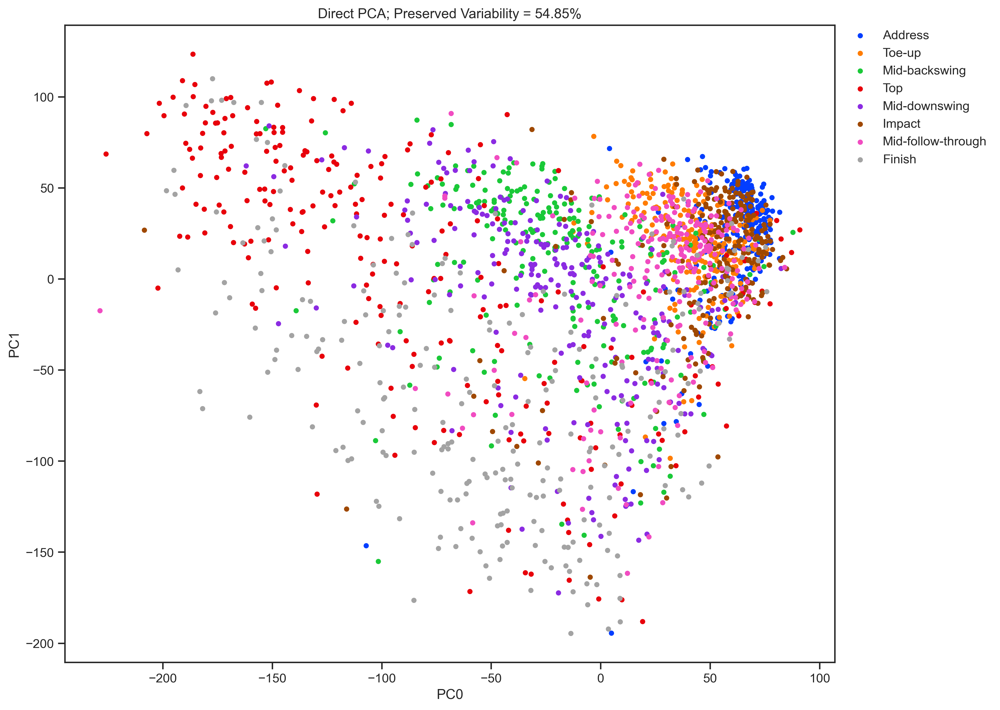

In [416]:
PC0 = sorted_eig_vec[:,0].reshape(-1,1)
PC1 = sorted_eig_vec[:,1].reshape(-1,1)

U_p_0_1 = np.hstack((PC0,PC1))

Y_0_1 = np.dot(U_p_0_1.T, X_centralised)

plt.figure(figsize=(12, 10))
for e in range(len(colors)):
    Y_df = Y_0_1[:, labels == e]
    plt.scatter(Y_df[0], Y_df[1], c=[colors[e]], label= event_names[e], marker='.', s=50)

plt.xlabel('PC0')
plt.ylabel('PC1')
plt.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.0, frameon = False)
plt.title(f"Direct PCA; Preserved Variability = {preserved_variability(sorted_eig_val, 0, 1)}%")
plt.show()


### Project to the worst 2D subspace

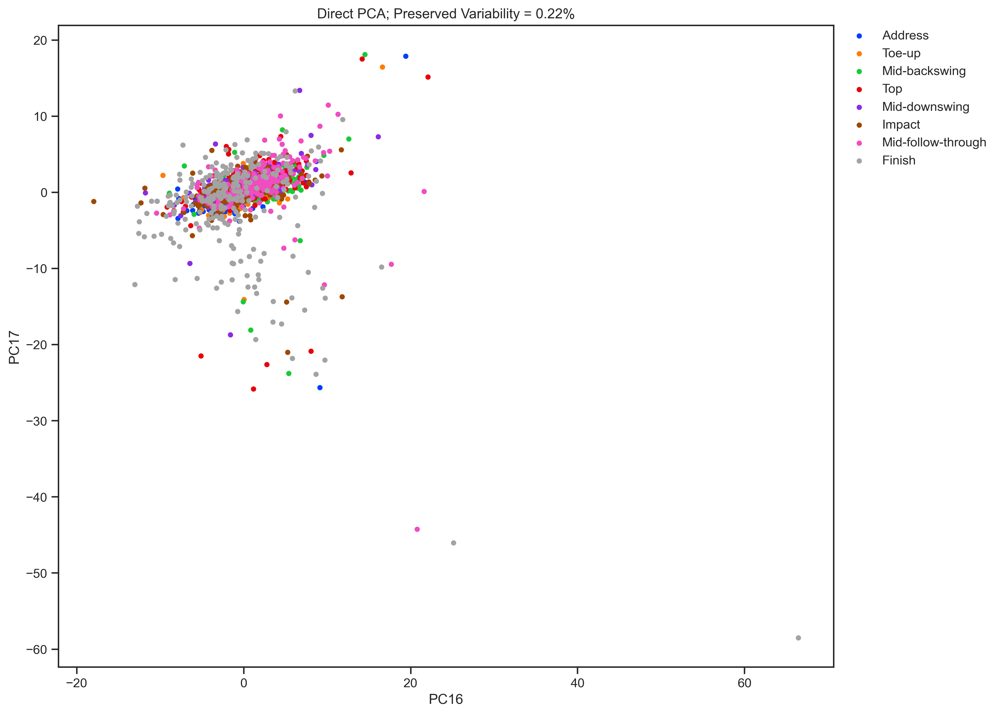

In [417]:
PC16 = sorted_eig_vec[:,16].reshape(-1,1)
PC17 = sorted_eig_vec[:,17].reshape(-1,1)

U_p_16_17 = np.hstack((PC16,PC17))

Y_16_17 = np.dot(U_p_16_17.T, X_centralised)

plt.figure(figsize=(12, 10))
for e in range(len(colors)):
    Y_df = Y_16_17[:, labels == e]
    plt.scatter(Y_df[0], Y_df[1], c=[colors[e]], label= event_names[e], marker='.', s=50)


plt.xlabel('PC16')
plt.ylabel('PC17')
plt.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.0, frameon = False)
plt.title(f"Direct PCA; Preserved Variability = {preserved_variability(sorted_eig_val, 16, 17)}%")
plt.show()


### Project to a 3D Subspace

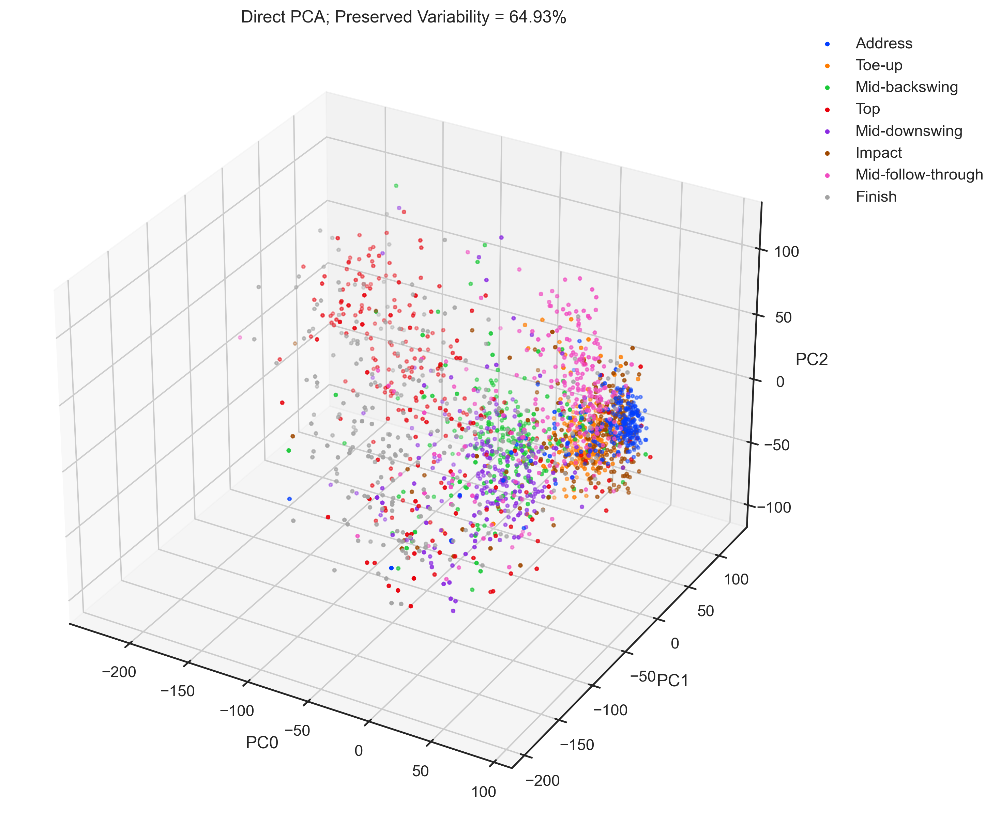

In [413]:
PC0 = sorted_eig_vec[:, 0].reshape(-1, 1)
PC1 = sorted_eig_vec[:, 1].reshape(-1, 1)
PC2 = sorted_eig_vec[:, 2].reshape(-1, 1)

U_p_0_1_2 = np.hstack((PC0, PC1, PC2))

Y_0_1_2 = np.dot(U_p_0_1_2.T, X_centralised)

fig = plt.figure(figsize=(20, 10))
ax = fig.add_subplot(111, projection='3d')

for e in range(len(colors)):
    Y_df = Y_0_1_2[:, labels == e]
    ax.scatter(Y_df[0], Y_df[1], Y_df[2], c=[colors[e]], label= event_names[e], marker='.', s=20)

ax.set_xlabel('PC0')
ax.set_ylabel('PC1')
ax.set_zlabel('PC2')
ax.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.0, frameon=False)

preserved_variance = preserved_variability(sorted_eig_val, 0, 1, 2)
ax.set_title(f"Direct PCA; Preserved Variability = {preserved_variance}%")

plt.show()


### Plot cumulative preserved variability

To come up with $p$, we can use this graph. The x-axis is $p$, and the y-axis is the preserved variability, which can be computed by

$$ \text{Preserved Variability} = \frac{\lambda_0 + \lambda_1 + \cdots + \lambda_{p-1}}{\lambda_0 + \lambda_1 + \cdots + \lambda_{d-1}} \times 100\% $$

According to the graph below, to preserve $\approx 90\%$ variability of the original data, you will need at least the first $p = 8$ eigenvectors to project the original data onto that $p$-dimensional subspace.

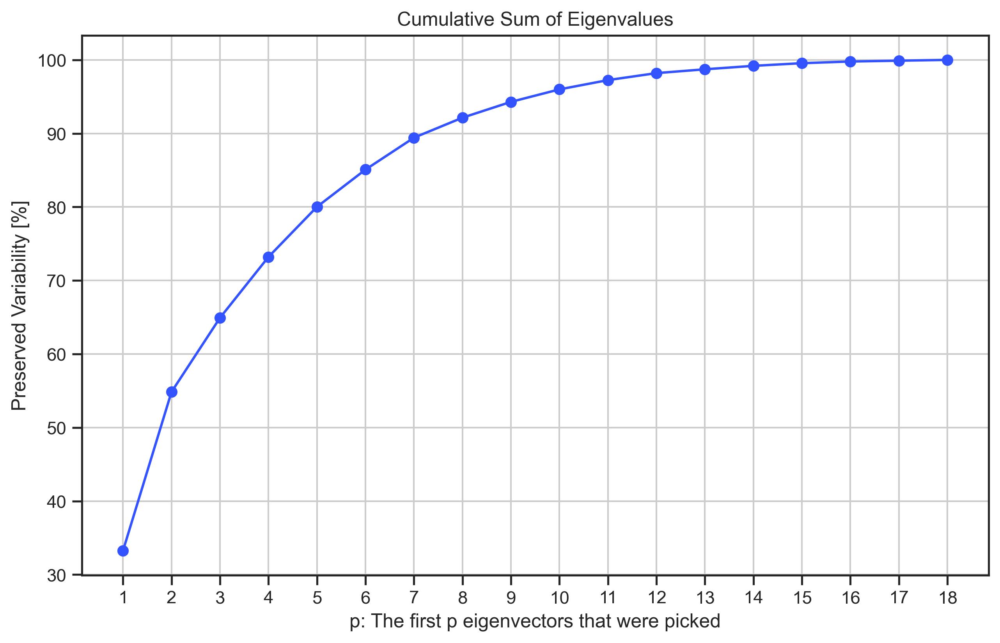

In [256]:
plot_cumulative_preserved_variability(sorted_eig_val)

### Interpret the principle components

The principle components are linear combinations of the original data variables (features). For example, in the below table, 

$$ PC_0 \equiv -0.029444 \times \text{Angle}_0 + -0.163831 \times \text{Angle}_1 + \cdots + 0.020870 \times \text{Angle}_{17}. $$

Therefore, the values of the principal component are equivalent to the weights of each corresponding feature.

In [210]:
column_names = [i for i in range(18)]
eigenvectors = pd.DataFrame(sorted_eig_vec, columns=[f"PC{i}" for i in range(0, 18)], index = column_names)
eigenvectors

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17
0,-0.029444,-0.110766,0.376296,0.461406,-0.055819,0.283552,-0.605456,0.225702,-0.248325,0.093493,0.193502,0.005559,-0.048330,-0.068071,-0.084148,0.029073,-0.090372,-0.019768
1,-0.163831,-0.022724,-0.387507,-0.437443,-0.563755,-0.074088,-0.517280,0.093179,0.051642,-0.090406,-0.008308,-0.007405,0.031272,-0.052696,-0.076643,0.045653,-0.092911,-0.015702
2,0.385443,-0.357262,0.558731,-0.187278,-0.273970,-0.530220,-0.020300,-0.097302,0.017289,0.006863,0.002436,0.091992,-0.011195,0.012402,0.026282,0.006304,0.025304,0.002585
3,0.391606,-0.174821,-0.460436,0.197057,0.482277,-0.417365,-0.367943,0.060672,0.057629,-0.065638,0.013687,-0.101315,0.026730,-0.009641,-0.014254,-0.009397,-0.014262,-0.004212
4,-0.056372,0.024409,-0.133387,-0.108788,-0.017705,-0.159025,0.036890,0.143182,-0.427791,0.503961,0.167673,0.019224,-0.082213,0.097919,0.180680,-0.163237,0.177794,0.588574
5,0.005864,-0.015646,0.075064,0.118167,-0.015024,0.145849,-0.165395,-0.076848,0.357923,-0.478005,-0.141225,0.211810,-0.112423,0.088927,0.199600,-0.145205,0.172294,0.626739
6,-0.528650,0.084530,0.049863,0.196547,0.076086,-0.356893,-0.208105,-0.691035,-0.087374,0.061008,-0.047576,0.054238,0.030228,-0.008220,-0.010452,0.023362,-0.005277,-0.006588
7,-0.545020,0.038408,0.219742,-0.087820,0.245147,-0.403156,0.033591,0.590299,0.184726,-0.163687,0.089201,-0.048579,0.003328,-0.015026,-0.020692,-0.013625,-0.034353,-0.000977
8,0.190382,0.627783,-0.065422,0.480762,-0.428315,-0.335361,0.107534,0.144127,0.064785,-0.027530,-0.005061,-0.024928,-0.014565,0.002290,-0.011019,-0.000503,0.001079,-0.005644
9,0.220537,0.647503,0.298502,-0.459621,0.330983,0.050272,-0.327077,-0.086893,-0.034103,0.018183,-0.020597,-0.048317,-0.002288,-0.009019,0.026379,-0.009029,0.004704,-0.001610


If we plot the magnitude of each principal component, we can see that, for example, angles 2, 3, 6, and 7 are the most significant features of the first principal component $(PC_0)$.

In [271]:
eigenvectors_abs = pd.DataFrame(np.abs(sorted_eig_vec), columns=[f"PC{i}" for i in range(1, 19)], index=column_names)
max_components = eigenvectors_abs.max().to_list()

# Create subplots
fig, axes = plt.subplots(6, 3, figsize=(20, 30))
axes = axes.flatten()

for i in range(18):
    sns.barplot(x=eigenvectors_abs.index, y=eigenvectors_abs.iloc[:, i], ax=axes[i], color="#3353FF")
    axes[i].set_title(f"Magnitude of each component of PC{i}")
    axes[i].set_ylabel(f"PC{i}")
    axes[i].set_xlabel("Angle")
    axes[i].tick_params(axis='x')

# Remove any empty subplots
for j in range(18, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

As you can see from the results, PCA may not be a good method for visualising high-dimensional data in lower-dimensional space because it uses a linear subspace, which may not be suitable for this complex data. Therefore, we will use other algorithms to see better results.

## **2. MDS**

We need to construct the distance matrix $D^{(X)}$ (ie. $d_{ij}^{(X)}$) of the given dataset $X \in R^{d \times n}$, which is given by

$$d_{ij}^{(X)} = \|\boldsymbol{x}_i-\boldsymbol{x}_j\|= \sqrt{(\boldsymbol x_i-\boldsymbol x_j)^T(\boldsymbol x_i-\boldsymbol x_j)}.$$

In [274]:
def distance_matrix(X):
    dim,num = X.shape
    D = np.zeros([num,num],np.float32)
    for i in range(num):
        for j in range(num):
            D[i,j] = np.dot((X[:,i]-X[:,j]).T,(X[:,i]-X[:,j])) #d_ij^2 is defined in here!!!!
    return D

In [375]:
angles_df = all_pros_df.drop(columns=["Pro's video","Label"])
labels = all_pros_df.iloc[:,-1]
X = angles_df.values.T
y = labels.values

In [377]:
D = distance_matrix(X)
D.shape

(1960, 1960)

We need to create a centering matrix $H \in R^{n\times n}$
$$H = I-\frac{1}{n}\boldsymbol{e}\boldsymbol{e}^{T},$$
where $\boldsymbol{e}=[1,1,\cdots,1]^{T}\in \mathbb{R}^{n\times 1}$. Then, construct a double centered matrix K, which reads
$$ K = -\frac{1}{2}HD^{2}H.$$

In [378]:
def H_matrix(size):
    e = np.ones((size,1),np.float32)
    I = np.identity(size) 
    H = I - (1.0/size)*np.dot(e, e.T) 
    return H

In [379]:
H = H_matrix(D.shape[0])
K = -0.5*np.dot(np.dot(H,D),H)

Determine the $p$ largest eigenvalues ${\Lambda_1,...,\Lambda_p}$ and correponding $p$ eigenvectors ${V_1,...,V_p}$ of $K$ defined in Step 2. 

In [380]:
def top_p_eigen_vectors_values(eig_val, eig_vec, p):

    eig_val = np.abs(eig_val)
    eig_val_ind = np.argsort(eig_val)
    eig_val_ind = eig_val_ind[::-1]
    eig_val_ind = eig_val_ind[0:p]
    
    eig_val_p = eig_val[eig_val_ind]
    V_p = eig_vec[:,eig_val_ind]
    
    return V_p, eig_val_p

In [381]:
p = 2
eig_val, eig_vec = np.linalg.eig(K)
V_p, eig_val_p = top_p_eigen_vectors_values(eig_val, eig_vec, p)

Finally, applying the equation

$$Y= \Lambda_p^{\frac{1}{2}} V_p^T$$

to reduce the dimensionality of original dataset. 

* $V_p$: consists of top-p eigenvectors 
* $\Lambda_p$: is a diagonal matrix whose diagonal entries are of the top-p eigenvalues

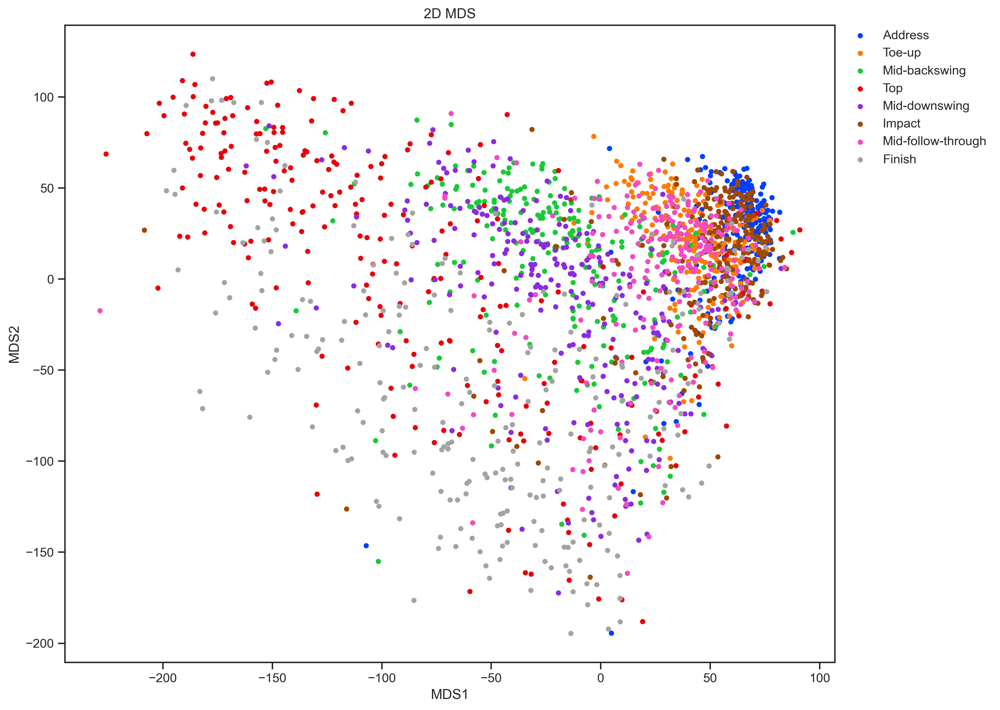

In [415]:
sigma_p = np.diag(eig_val_p**0.5)
Y = np.dot(sigma_p, V_p.T)

plt.figure(figsize=(12, 10))
for e in range(len(colors)):
    Y_df = Y[:, labels == e]
    plt.scatter(Y_df[0], Y_df[1], c=[colors[e]], label= event_names[e], marker='.', s=50)

plt.xlabel('MDS1')
plt.ylabel('MDS2')
plt.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.0, frameon = False)
plt.title("2D MDS")
plt.show()

## **3. Isomap**

In [389]:
def geodesic_distance_dijkstra(X, num_k_points = 15):
   
    kng = kneighbors_graph(X.T, num_k_points, mode='distance')
    D_G = shortest_path(kng, method='D', directed=False)
    
    return kng, D_G

def plot_isomap(num_k_points_list, X, colors, labels, event_names):
    fig, axes = plt.subplots(2, 2, figsize=(12, 10))
    axes = axes.flatten()  # Flatten the 2x2 array of axes for easy indexing

    for i, num_k_points in enumerate(num_k_points_list):
        _, D_G = geodesic_distance_dijkstra(X, num_k_points)
        H = H_matrix(X.shape[1])
        K = -0.5 * np.dot(np.dot(H, D_G**2), H)

        eig_val, eig_vec = np.linalg.eig(K)
        V_p, eig_val_p = top_p_eigen_vectors_values(eig_val, eig_vec, 2)
        sigma_p = np.diag(eig_val_p**0.5)
        Y = np.dot(sigma_p, V_p.T)
        
        plt.figure(figsize=(12, 10))
        for e in range(len(colors)):
            Y_df = Y[:, labels == e]
            axes[i].scatter(Y_df[0], Y_df[1], c=[colors[e]], label=event_names[e], marker='.', s=5)

        axes[i].set_xlabel('ISO1')
        axes[i].set_ylabel('ISO2')
        axes[i].set_title(f"2D Isomap (k={num_k_points})")
        
    plt.tight_layout()
    plt.show()


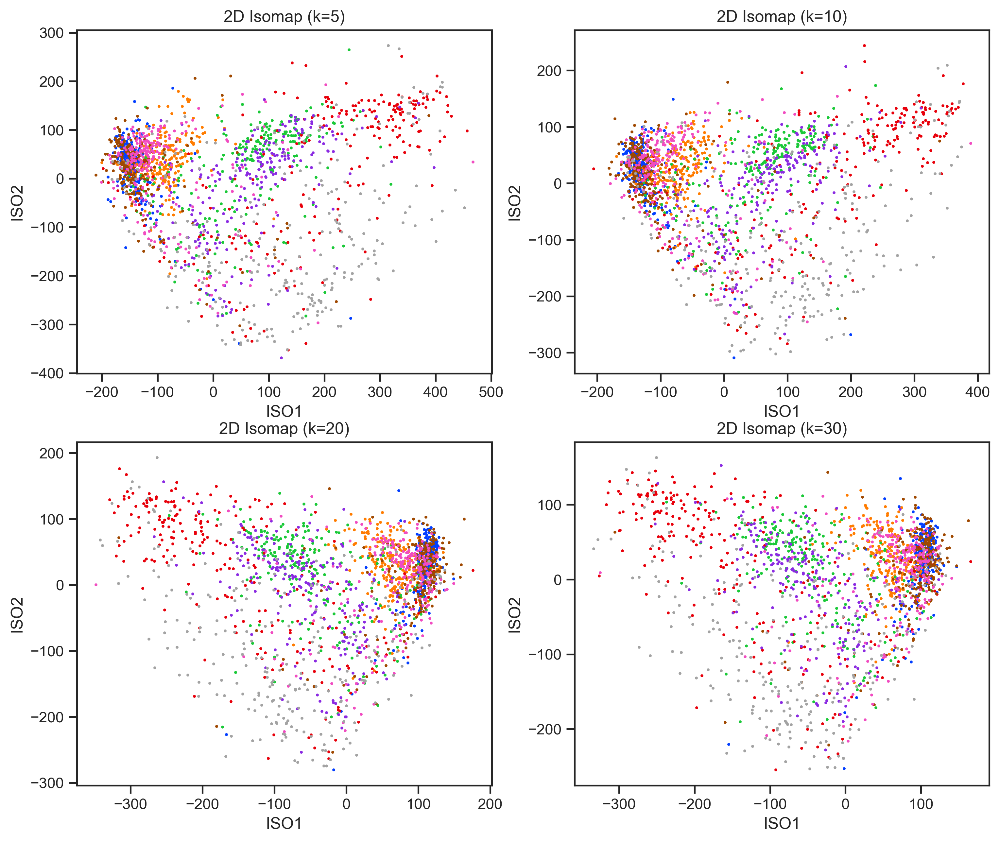

<Figure size 3600x3000 with 0 Axes>

<Figure size 3600x3000 with 0 Axes>

<Figure size 3600x3000 with 0 Axes>

<Figure size 3600x3000 with 0 Axes>

In [390]:
num_k_points_list = [5, 10, 20, 30]
plot_isomap(num_k_points_list, X, colors, labels, event_names)

## **4. SNE**

In [303]:
def neg_squared_euc_dists(X):
    sum_X = np.sum(np.square(X), 1)
    D = np.add(np.add(-2 * np.dot(X, X.T), sum_X).T, sum_X)
    return -D

In [304]:
def softmax(X, diag_zero=True):
    """Take softmax of each row of matrix X."""

    # Subtract max for numerical stability
    e_x = np.exp(X - np.max(X, axis=1).reshape([-1, 1]))

    # We usually want diagonal probailities to be 0.
    if diag_zero:
        np.fill_diagonal(e_x, 0.)

    # Add a tiny constant for stability of log we take later
    e_x = e_x + 1e-8  # numerical stability

    return e_x / e_x.sum(axis=1).reshape([-1, 1])

In [305]:
def calc_prob_matrix(distances, sigmas=None):
    """Convert a distances matrix to a matrix of probabilities."""
    if sigmas is not None:
        two_sig_sq = 2. * np.square(sigmas.reshape((-1, 1)))
        return softmax(distances / two_sig_sq)
    else:
        return softmax(distances)

In [306]:
def binary_search(eval_fn, target, tol=1e-10, max_iter=10000, 
                  lower=1e-20, upper=1000.):
    """Perform a binary search over input values to eval_fn.
    
    # Arguments
        eval_fn: Function that we are optimising over.
        target: Target value we want the function to output.
        tol: Float, once our guess is this close to target, stop.
        max_iter: Integer, maximum num. iterations to search for.
        lower: Float, lower bound of search range.
        upper: Float, upper bound of search range.
    # Returns:
        Float, best input value to function found during search.
    """
    for i in range(max_iter):
        guess = (lower + upper) / 2.
        val = eval_fn(guess)
        if val > target:
            upper = guess
        else:
            lower = guess
        if np.abs(val - target) <= tol:
            break

    return guess

In [307]:
def calc_perplexity(prob_matrix):
    """Calculate the perplexity of each row 
    of a matrix of probabilities."""
    entropy = -np.sum(prob_matrix * np.log2(prob_matrix), 1)
    perplexity = 2 ** entropy
    return perplexity


def perplexity(distances, sigmas):
    """Wrapper function for quick calculation of 
    perplexity over a distance matrix."""

    return calc_perplexity(calc_prob_matrix(distances, sigmas))


def find_optimal_sigmas(distances, target_perplexity):
    """For each row of distances matrix, find sigma that results
    in target perplexity for that role."""
    sigmas = [] 
    # For each row of the matrix (each point in our dataset)
    for i in range(distances.shape[0]):
        # Make fn that returns perplexity of this row given sigma
        eval_fn = lambda sigma: \
            perplexity(distances[i:i+1, :], np.array(sigma))
        # Binary search over sigmas to achieve target perplexity
        correct_sigma = binary_search(eval_fn, target_perplexity)
        # Append the resulting sigma to our output array
        sigmas.append(correct_sigma)

    return np.array(sigmas)

In [308]:
def q_joint(Y):
    """Given low-dimensional representations Y, compute
    matrix of joint probabilities with entries q_ij."""
    # Get the distances from every point to every other
    distances = neg_squared_euc_dists(Y)
    # Take the elementwise exponent
    exp_distances = np.exp(distances)
    # Fill diagonal with zeroes so q_ii = 0
    np.fill_diagonal(exp_distances, 0.)
    # Divide by the sum of the entire exponentiated matrix
    
    return exp_distances / np.sum(exp_distances), None


def p_conditional_to_joint(P):
    """Given conditional probabilities matrix P, return
    approximation of joint distribution probabilities."""
    
    return (P + P.T) / (2. * P.shape[0])

In [309]:
def p_joint(X, target_perplexity):
    """Given a data matrix X, gives joint probabilities matrix.

    # Arguments
        X: Input data matrix.
    # Returns:
        P: Matrix with entries p_ij = joint probabilities.
    """
    # Get the negative euclidian distances matrix for our data
    distances = neg_squared_euc_dists(X)
    # Find optimal sigma for each row of this distances matrix
    sigmas = find_optimal_sigmas(distances, target_perplexity)
    # Calculate the probabilities based on these optimal sigmas
    p_conditional = calc_prob_matrix(distances, sigmas)
    # Go from conditional to joint probabilities matrix
    P = p_conditional_to_joint(p_conditional)

    return P

In [310]:
def symmetric_sne_grad(P, Q, Y, _):
    """Estimate the gradient of the cost with respect to Y"""
    pq_diff = P - Q  # NxN matrix
    pq_expanded = np.expand_dims(pq_diff, 2)  #NxNx1
    y_diffs = np.expand_dims(Y, 1) - np.expand_dims(Y, 0)  #NxNx2
    grad = 4. * (pq_expanded * y_diffs).sum(1)  #Nx2
    return grad

In [425]:
def categorical_scatter_2d(X2D, class_idxs, iter, ms, ax=None, alpha=1, 
                           legend=True, figsize=(12, 10), show=False, 
                           savename=None, event_names=event_names):
    if ax is None:
        fig, ax = plt.subplots(figsize=figsize)
    
    classes = list(np.unique(class_idxs))
    colors = sns.color_palette("bright", len(classes))
    
    for i, cls in enumerate(classes):
        Y_df = X2D[class_idxs == cls]
        ax.scatter(Y_df[:, 0], Y_df[:, 1], c=[colors[i]], label=str(cls) if event_names is None else event_names[i], marker='o', s=ms, alpha=alpha)
    
    ax.set_xlabel('SNE1')
    ax.set_ylabel('SNE2')
    if legend:
        ax.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.0, frameon=False)
    ax.set_title(f"2D SNE (Iteration: {iter+1})")
    
    if savename is not None:
        plt.tight_layout()
        plt.savefig(savename)
    
    if show:
        plt.show()
    
    return ax



In [426]:
# This training loop function will perform gradient descent:
def estimate_sne(X, y, P, rng, num_iters, q_fn, grad_fn, learning_rate,
                 momentum, plot):
    """Estimates a SNE model.

    # Arguments
        X: Input data matrix.
        y: Class labels for that matrix.
        P: Matrix of joint probabilities.
        rng: np.random.RandomState().
        num_iters: Iterations to train for.
        q_fn: Function that takes Y and gives Q prob matrix.
        plot: How many times to plot during training.
    # Returns:
        Y: Matrix, low-dimensional representation of X.
    """

    # Initialise our 2D representation
    Y = rng.normal(0., 0.0001, [X.shape[0], 2])

    # Initialise past values (used for momentum)
    if momentum:
        Y_m2 = Y.copy()
        Y_m1 = Y.copy()

    # Start gradient descent loop
    for i in range(num_iters):

        # Get Q and distances (distances only used for t-SNE)
        Q, distances = q_fn(Y)
        # Estimate gradients with respect to Y
        grads = grad_fn(P, Q, Y, distances)

        # Update Y
        Y = Y - learning_rate * grads
        if momentum:  # Add momentum
            Y += momentum * (Y_m1 - Y_m2)
            # Update previous Y's for momentum
            Y_m2 = Y_m1.copy()
            Y_m1 = Y.copy()

        # Plot sometimes
        if plot and (i % (num_iters // plot) == 0 or i == num_iters - 1):
            categorical_scatter_2d(Y, y, iter=i, alpha=1.0, ms=20,
                                   show=True, figsize=(12, 10))

    return Y

In [440]:
# Set global parameters
PERPLEXITY = 20
SEED = 1                    # Random seed
MOMENTUM = 0.9
LEARNING_RATE = 10.
NUM_ITERS = 1000              # Num iterations to train for
TSNE = False                # If False, Symmetric SNE
NUM_PLOTS = 5               # Num. times to plot in training


def SNE(X, y):
    # numpy RandomState for reproducibility
    rng = np.random.RandomState(SEED)
    # Obtain matrix of joint probabilities p_ij
    P = p_joint(X, PERPLEXITY)

    # Fit SNE or t-SNE
    Y = estimate_sne(X, y, P, rng,
             num_iters=NUM_ITERS,
             q_fn=q_joint,
             grad_fn=symmetric_sne_grad,
             learning_rate=LEARNING_RATE,
             momentum=MOMENTUM,
             plot=NUM_PLOTS)
    

In [441]:
# Convert to numpy arrays and remove row/column names
X = angles_df.values
y = labels.values

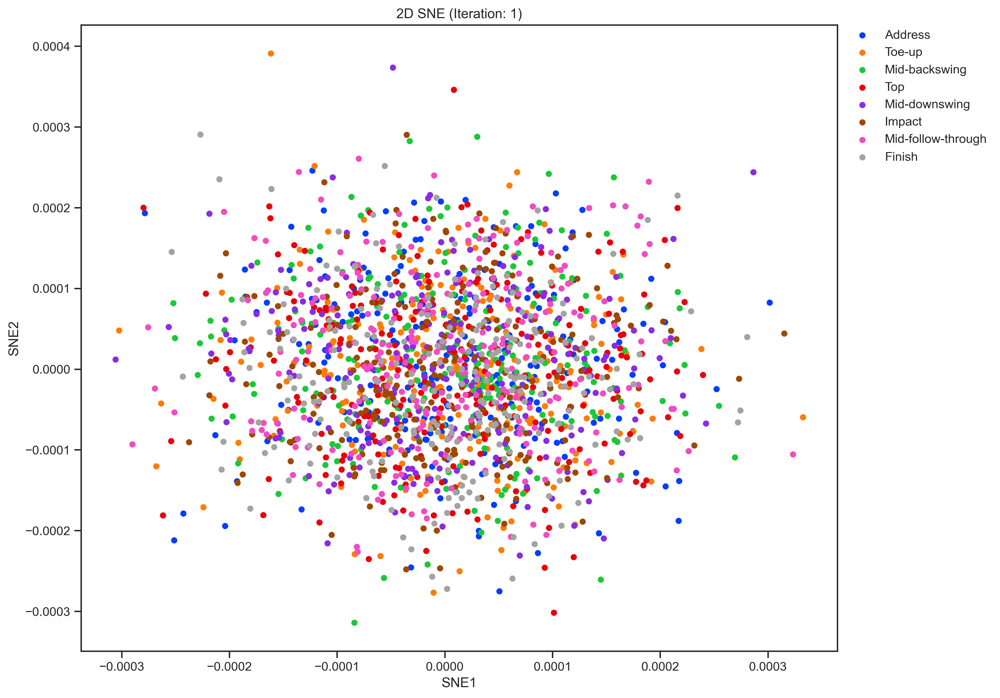

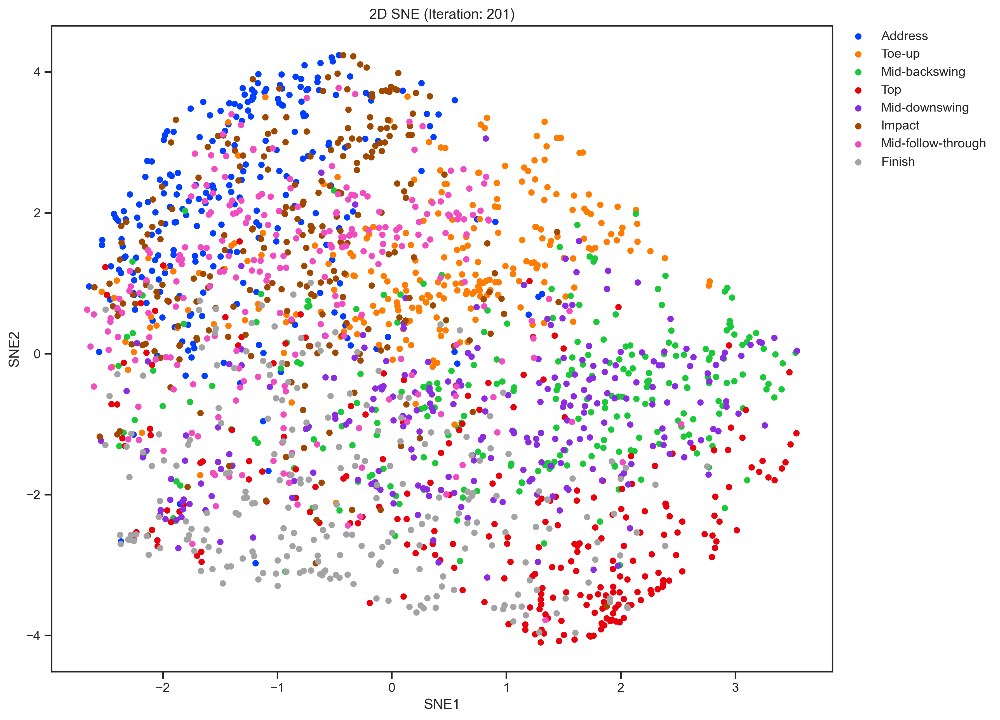

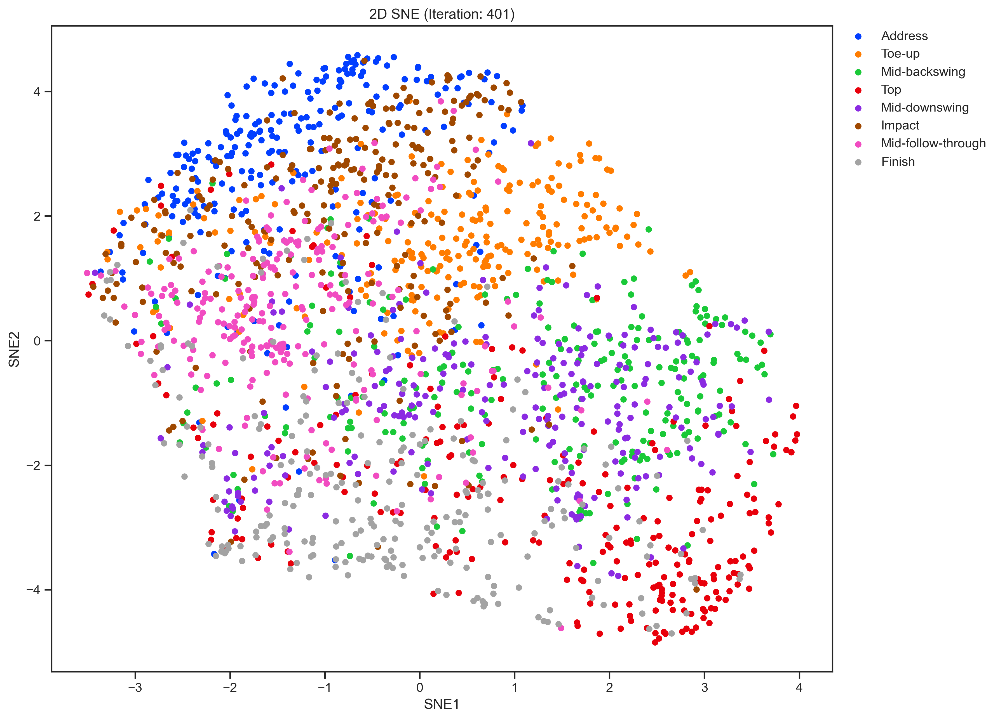

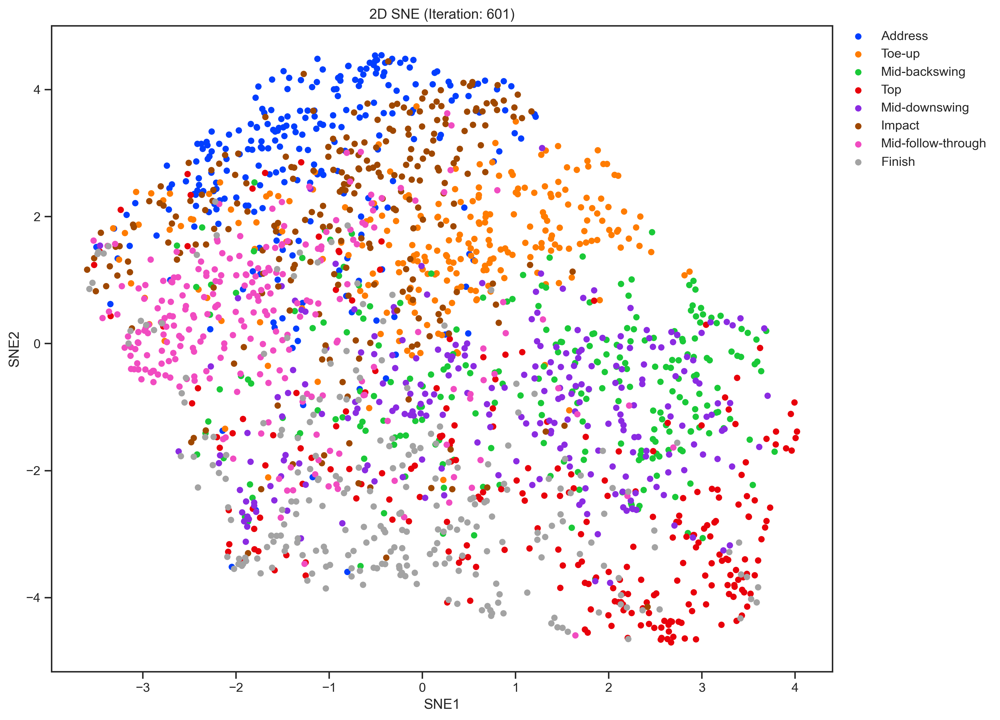

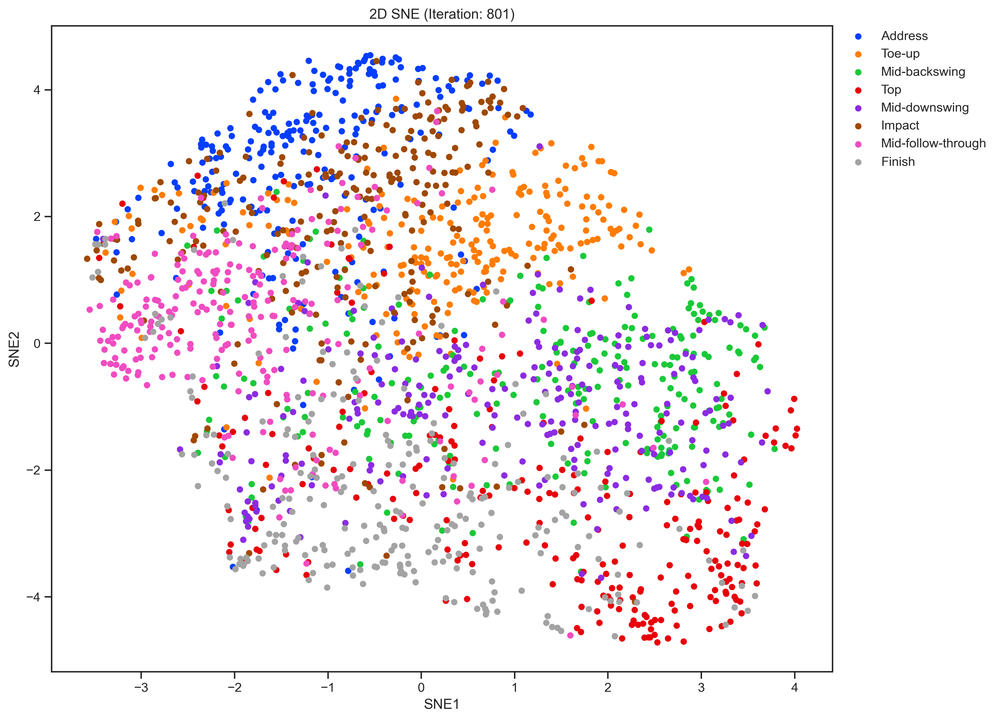

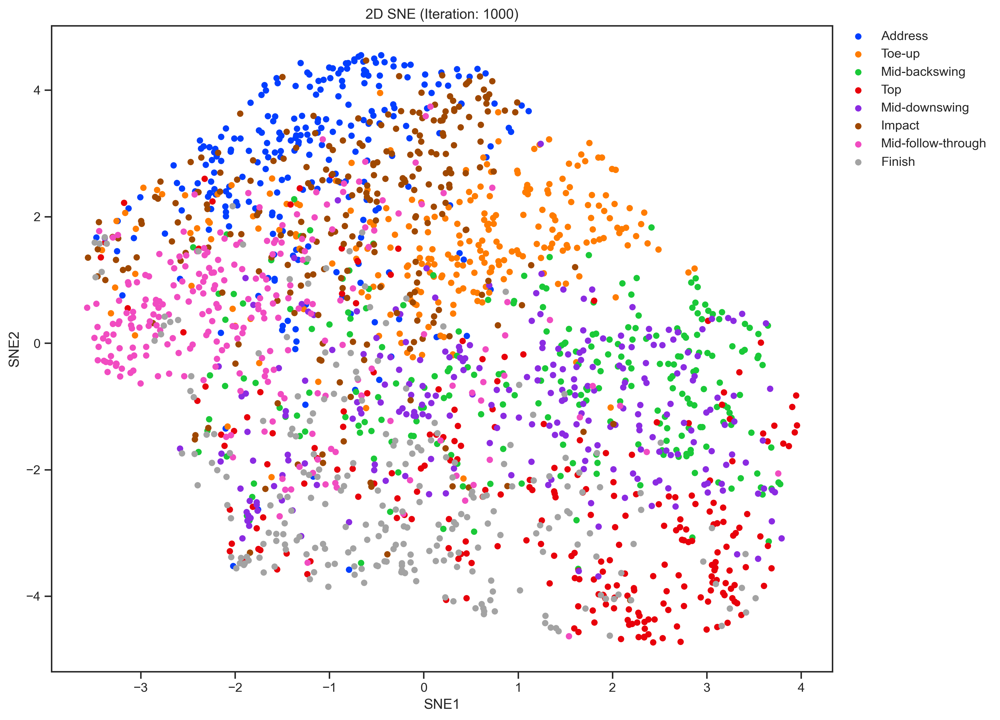

In [442]:
SNE(X, y)

In [443]:
def q_tsne(Y):
    """t-SNE: Given low-dimensional representations Y, compute
    matrix of joint probabilities with entries q_ij."""
    distances = neg_squared_euc_dists(Y)
    inv_distances = np.power(1. - distances, -1)
    np.fill_diagonal(inv_distances, 0.)
    return inv_distances / np.sum(inv_distances), inv_distances

In [444]:
def tsne_grad(P, Q, Y, inv_distances):
    """Estimate the gradient of t-SNE cost with respect to Y."""
    pq_diff = P - Q
    pq_expanded = np.expand_dims(pq_diff, 2)
    y_diffs = np.expand_dims(Y, 1) - np.expand_dims(Y, 0)

    # Expand our inv_distances matrix so can multiply by y_diffs
    distances_expanded = np.expand_dims(inv_distances, 2)

    # Multiply this by inverse distances matrix
    y_diffs_wt = y_diffs * distances_expanded

    # Multiply then sum over j's
    grad = 4. * (pq_expanded * y_diffs_wt).sum(1)
    return grad

In [445]:
# Set global parameters
PERPLEXITY = 20
SEED = 1                    # Random seed
MOMENTUM = 0.9
LEARNING_RATE = 10.
NUM_ITERS = 1000              # Num iterations to train for
TSNE = False                # If False, Symmetric SNE
NUM_PLOTS = 5               # Num. times to plot in training


def TSNE(X, y):
    # numpy RandomState for reproducibility
    rng = np.random.RandomState(SEED)
    # Obtain matrix of joint probabilities p_ij
    P = p_joint(X, PERPLEXITY)

    # Fit SNE or t-SNE
    Y = estimate_sne(X, y, P, rng,
             num_iters=NUM_ITERS,
             q_fn=q_tsne,
             grad_fn=tsne_grad,
             learning_rate=LEARNING_RATE,
             momentum=MOMENTUM,
             plot=NUM_PLOTS)

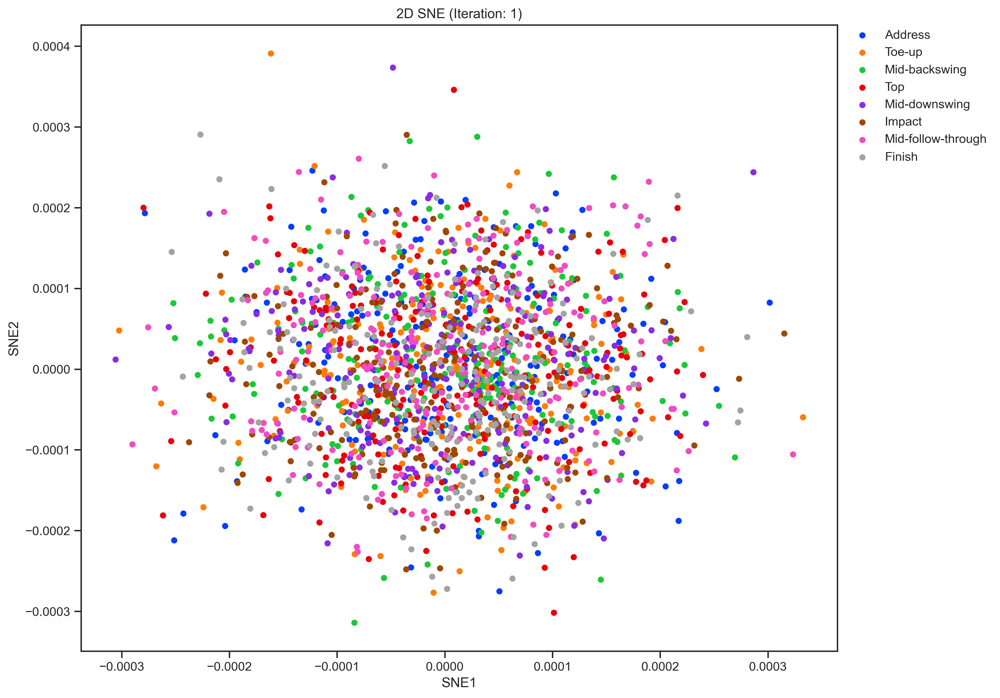

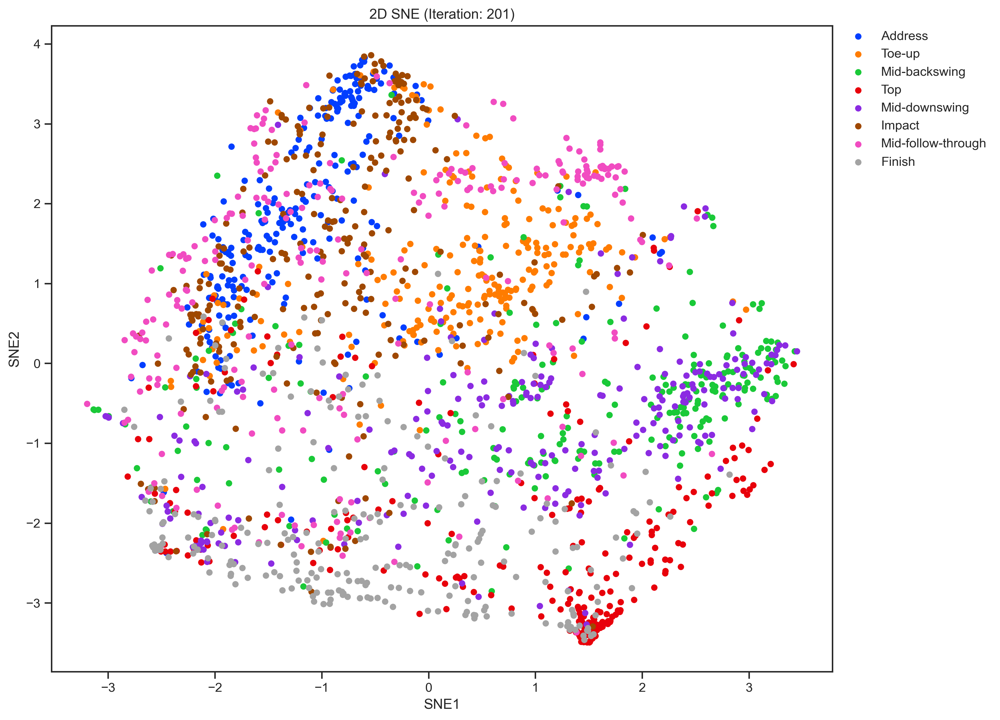

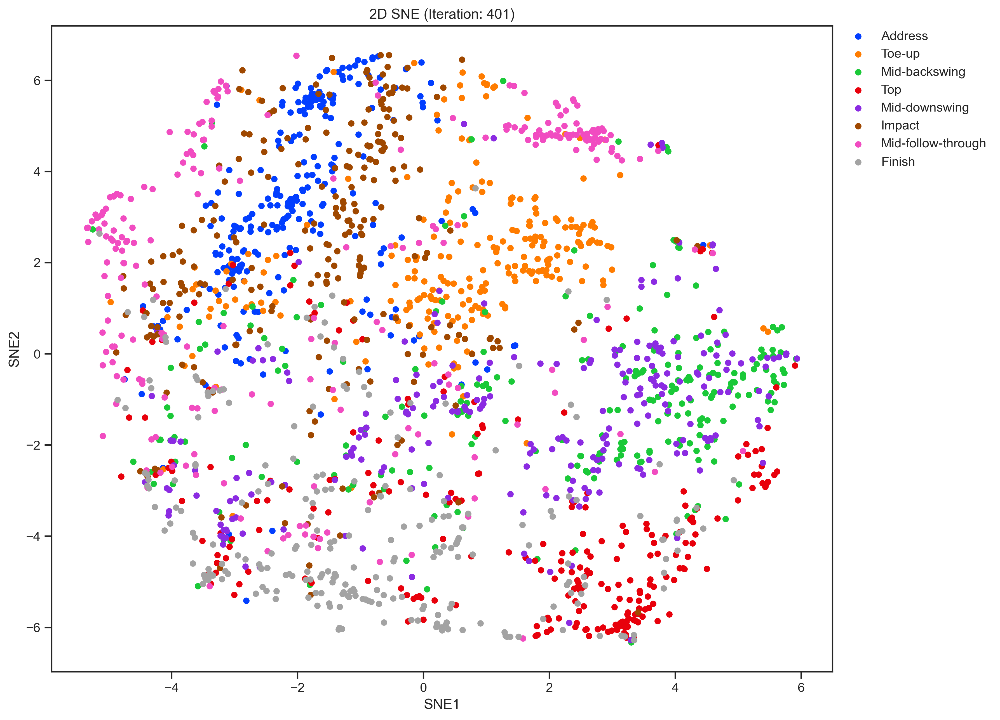

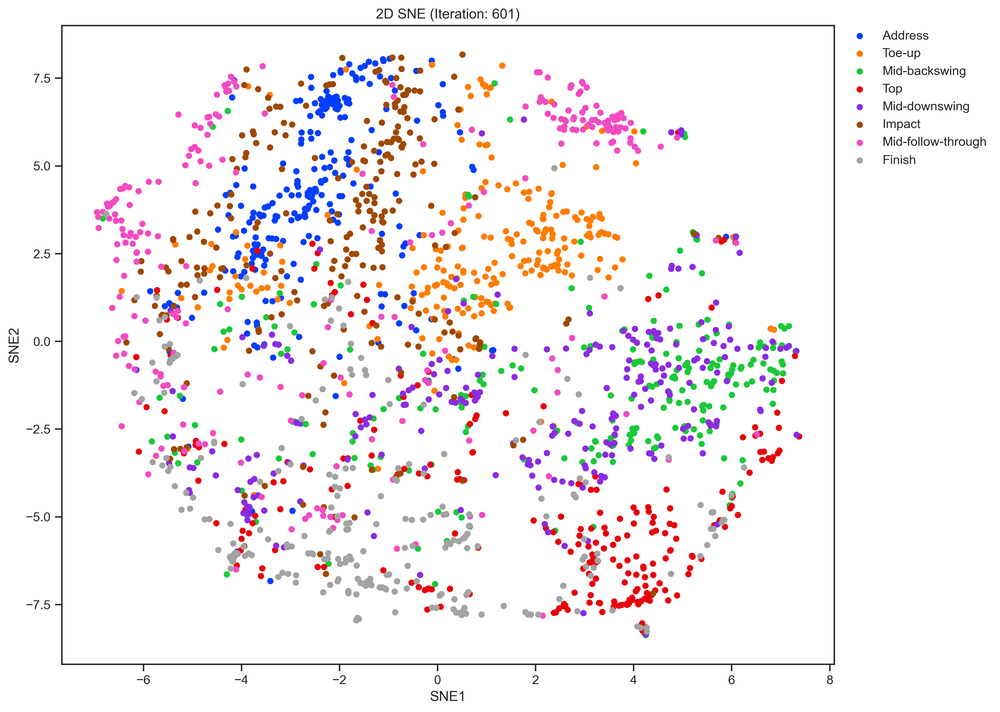

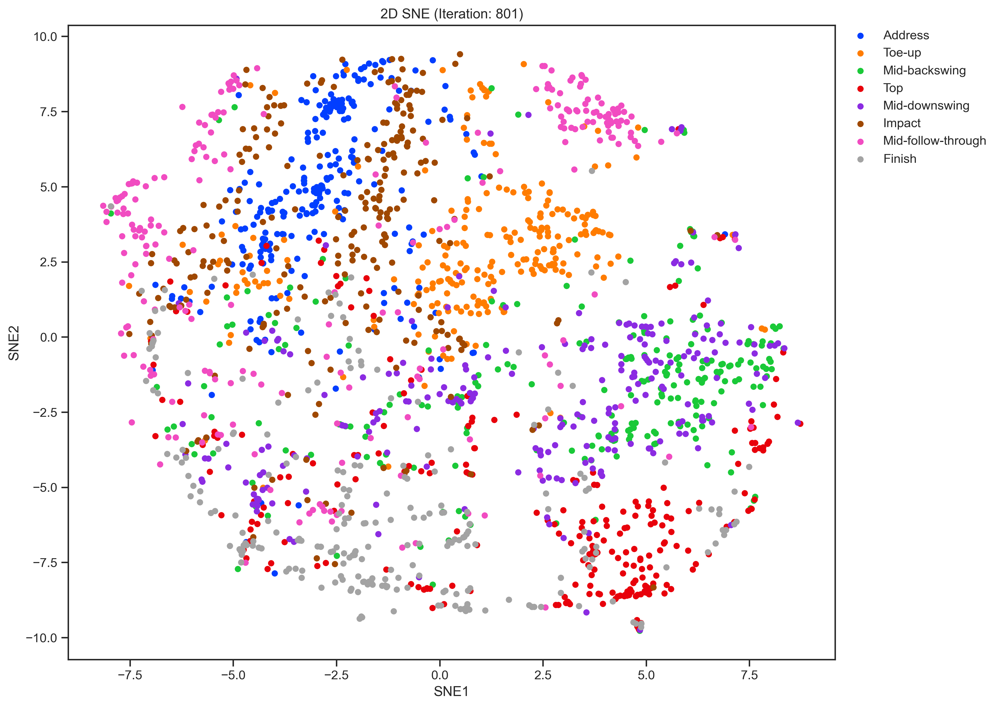

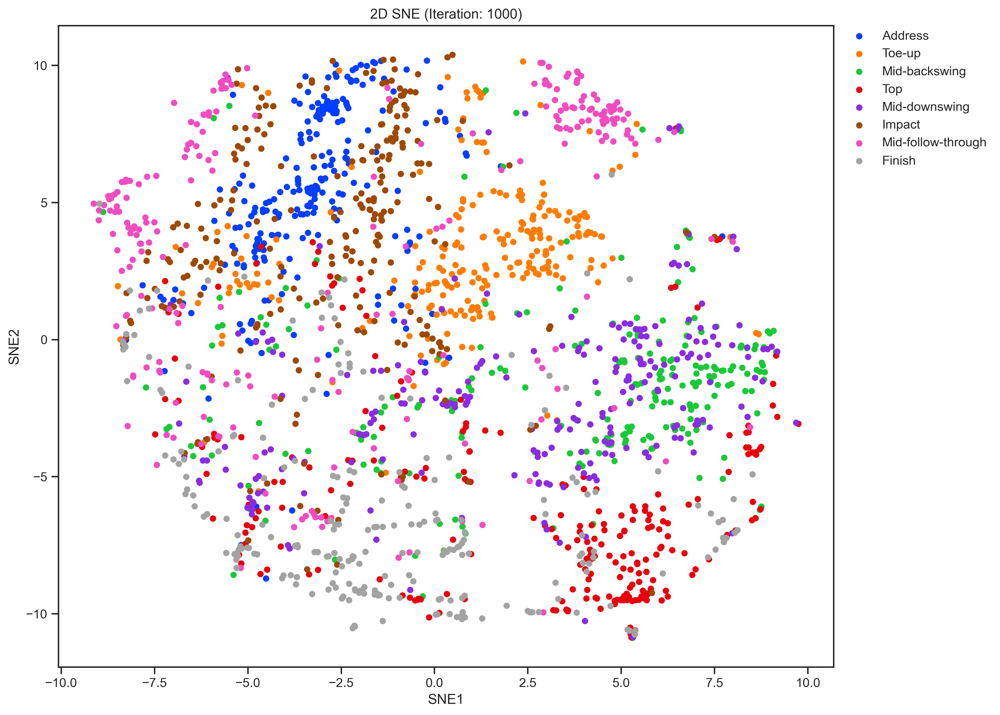

In [446]:
TSNE(X, y)

## 5. Conclusion



*The 2D visualisation of the data set via PCA, MDS, Isomap and t-SNE, respectively*

<img src="./Information/Compilation.png" alt="PNG Image" width="1000"/>

<img src="./Information/tsne.png" alt="PNG Image" width="1000"/>


Personally, I believe that t-SNE did the best job in visualising my data set because it allows us to infer some of the points here:

* Mid-backswing and Mid-downswing points are in the same position due to the identical posture.

* Address and impact are in the same/near positions due to their similar postures.

* Mid-follow-through, Toe-up, Finish, and Top are grouped in their individual areas due to their distinct postures.

# BONUS: Use built-in functions in Python to perform the above algorithms

## PCA

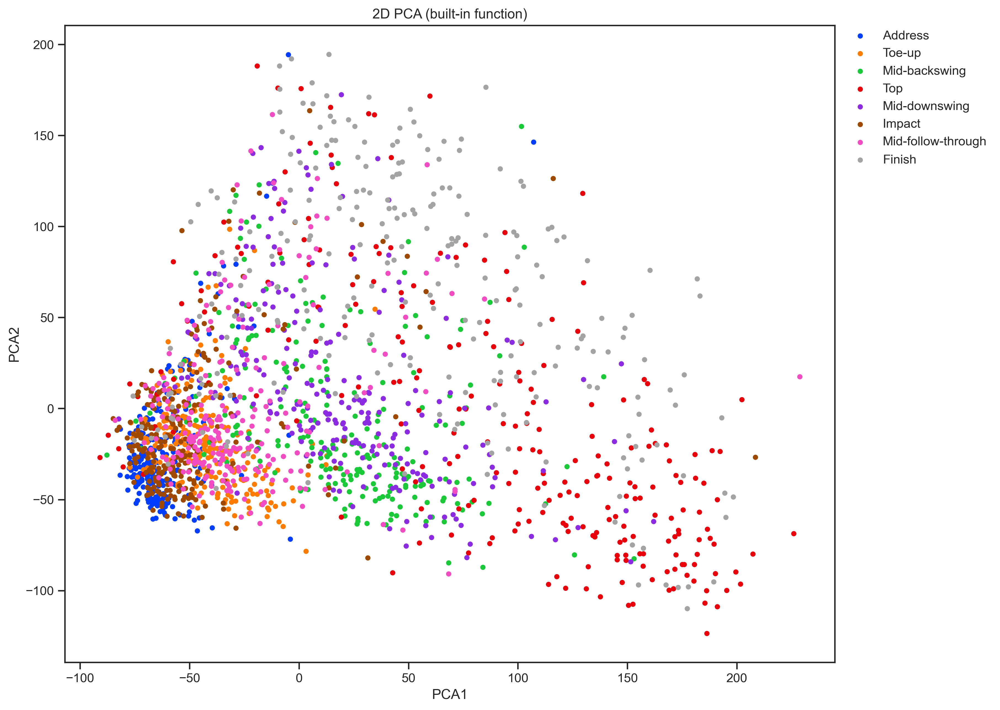

In [436]:
# Initialize the PCA model
pca = PCA(n_components=2)

# Fit and transform the data
pca_transformed = pca.fit_transform(angles_df)

# Transpose the transformed data for easier slicing
Y = pca_transformed.T

plt.figure(figsize=(12, 10))
for e in range(len(colors)):
    Y_df = Y[:, labels == e]
    plt.scatter(Y_df[0], Y_df[1], c=[colors[e]], label=event_names[e], marker='.', s=50)

plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.0, frameon=False)
plt.title("2D PCA (built-in function)")
plt.show()

## MDS

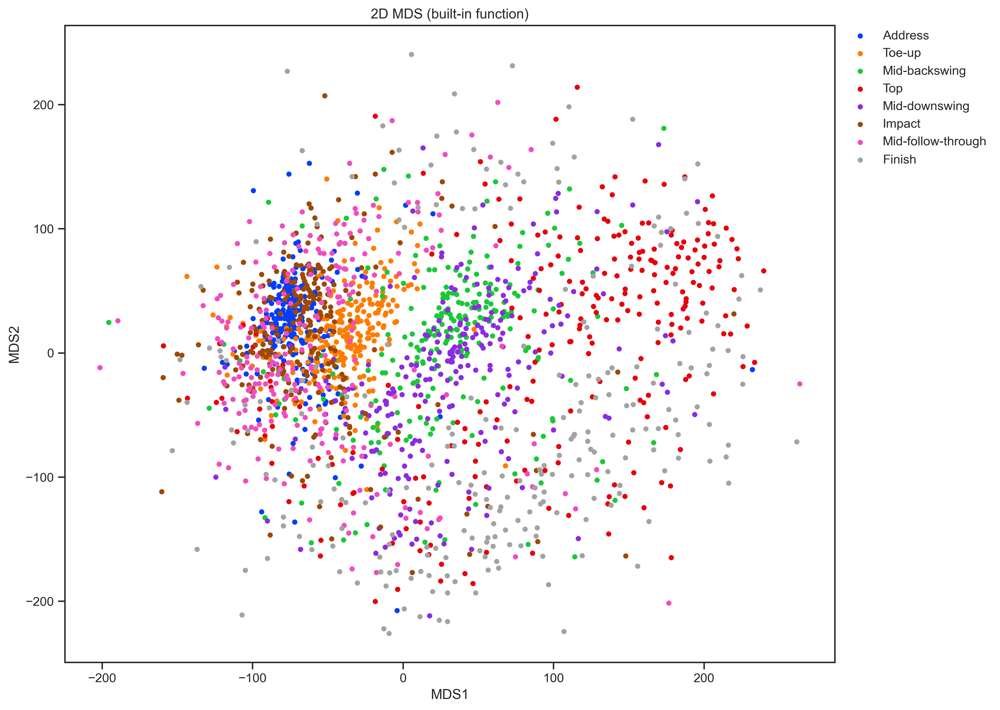

In [438]:
# Initialize the MDS model
mds = MDS(n_components=2, random_state=42, normalized_stress='auto')

# Fit and transform the data
mds_transformed = mds.fit_transform(angles_df)

# Transpose the transformed data for easier slicing
Y = mds_transformed.T

plt.figure(figsize=(12, 10))
for e in range(len(colors)):
    Y_df = Y[:, labels == e]
    plt.scatter(Y_df[0], Y_df[1], c=[colors[e]], label= event_names[e], marker='.', s=50)

plt.xlabel('MDS1')
plt.ylabel('MDS2')
plt.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.0, frameon = False)
plt.title("2D MDS (built-in function)")
plt.show()

## Isomap

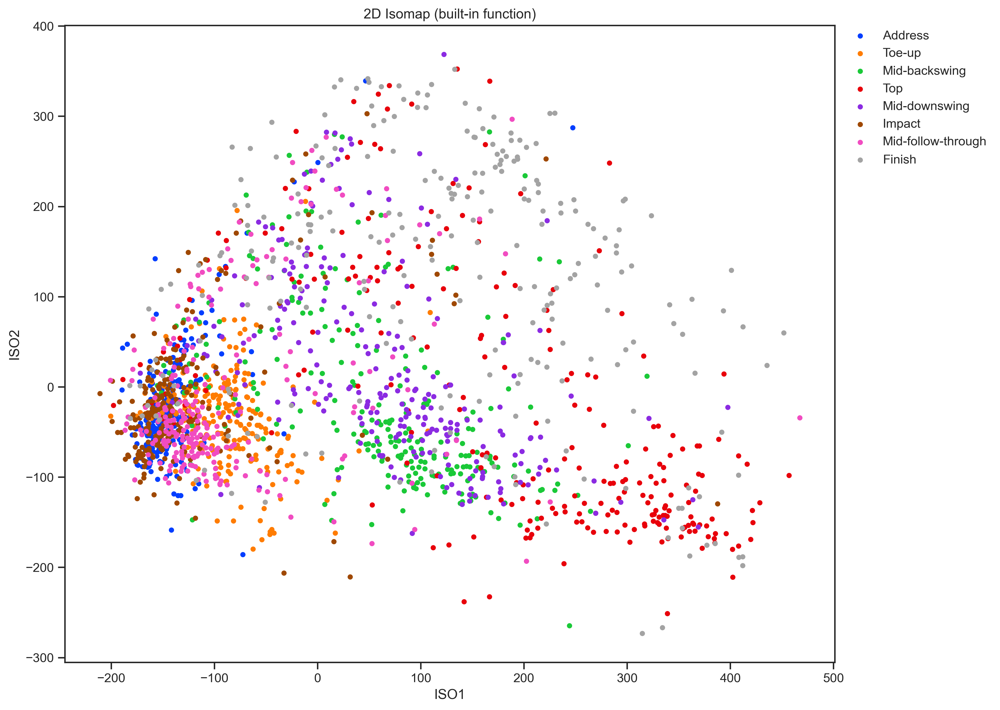

In [434]:
# Initialize the Isomap model
isomap = Isomap(n_components=2)

# Fit and transform the data
isomap_transformed = isomap.fit_transform(angles_df)

# Transpose the transformed data for easier slicing
Y = isomap_transformed.T

plt.figure(figsize=(12, 10))
for e in range(len(colors)):
    Y_df = Y[:, labels == e]
    plt.scatter(Y_df[0], Y_df[1], c=[colors[e]], label= event_names[e], marker='.', s=50)

plt.xlabel('ISO1')
plt.ylabel('ISO2')
plt.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.0, frameon = False)
plt.title("2D Isomap (built-in function)")
plt.show()

## t-SNE

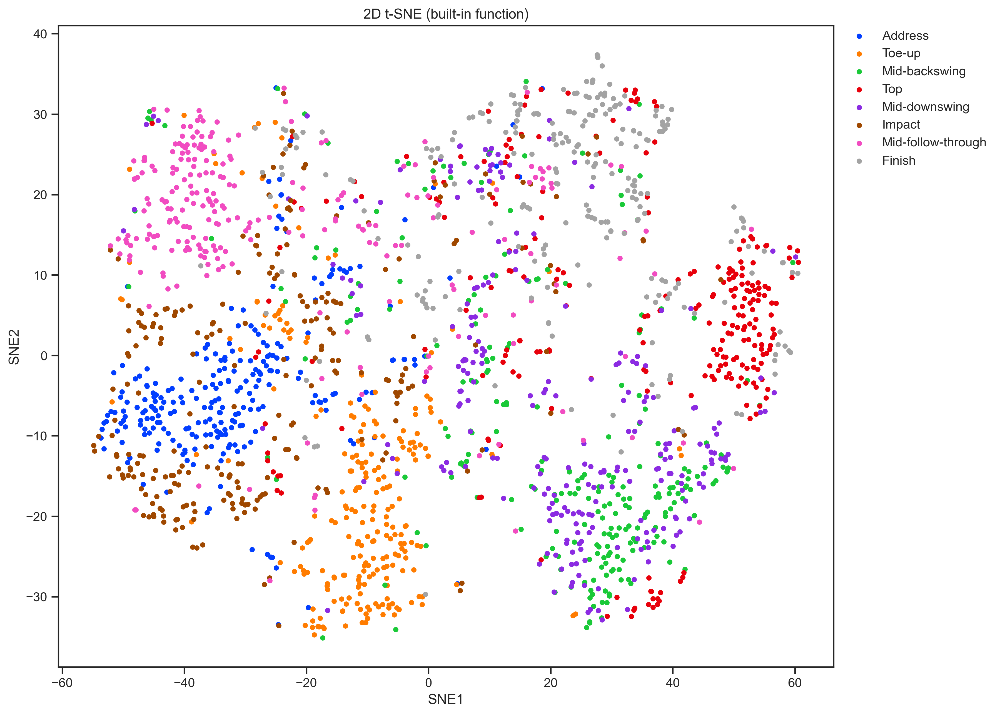

In [437]:
# Initialize the t-SNE model
tsne = TSNE(n_components=2, random_state=42)

# Fit and transform the data
tsne_transformed = tsne.fit_transform(angles_df)

# Transpose the transformed data for easier slicing
Y = tsne_transformed.T

plt.figure(figsize=(12, 10))
for e in range(len(colors)):
    Y_df = Y[:, labels == e]
    plt.scatter(Y_df[0], Y_df[1], c=[colors[e]], label= event_names[e], marker='.', s=50)

plt.xlabel('SNE1')
plt.ylabel('SNE2')
plt.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.0, frameon = False)
plt.title("2D t-SNE (built-in function)")
plt.show()